In [37]:
import numpy as np
import cv2 as cv
import glob
from matplotlib import pyplot as plt

In [38]:
images = glob.glob('img/input/*.jpg')

## Showing images

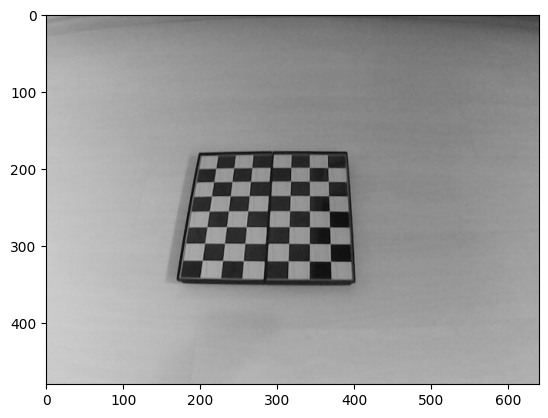

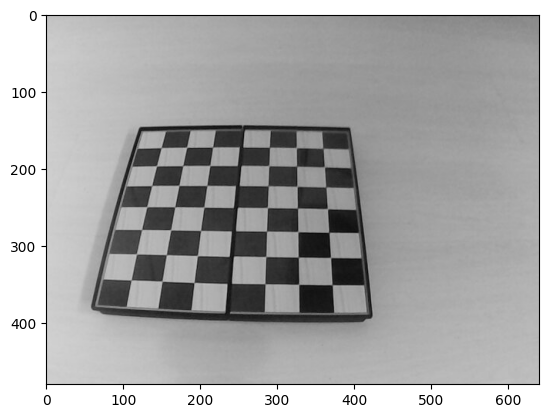

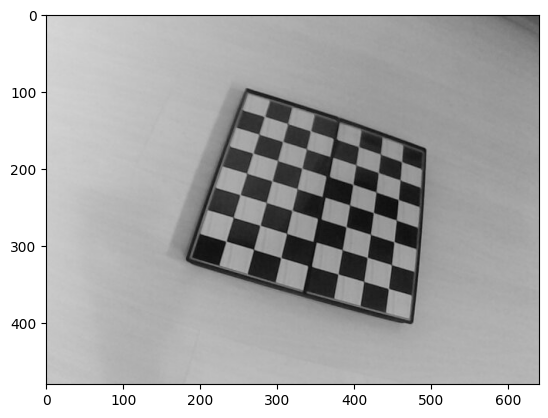

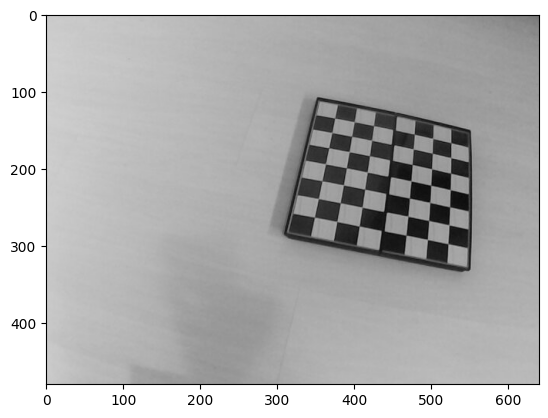

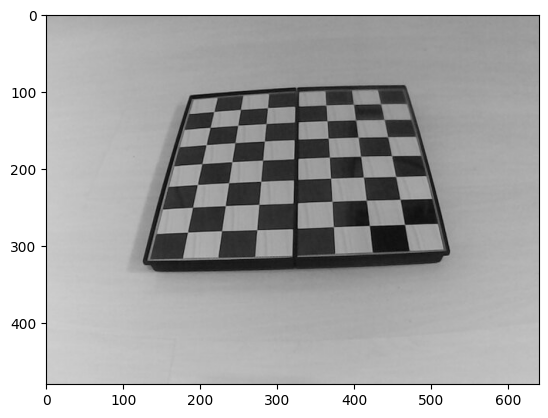

...

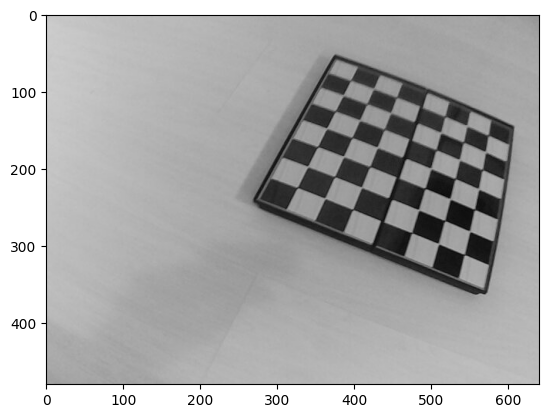

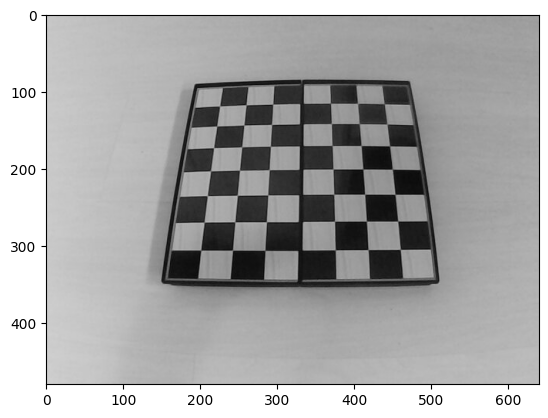

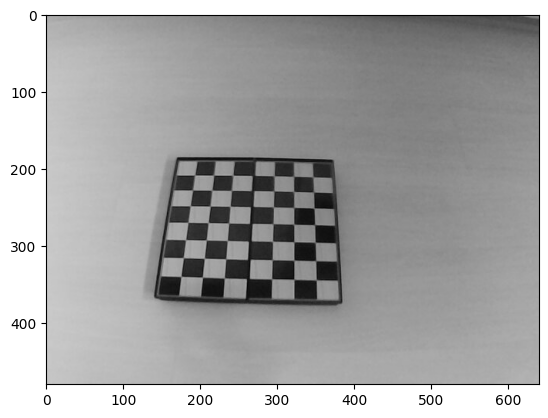

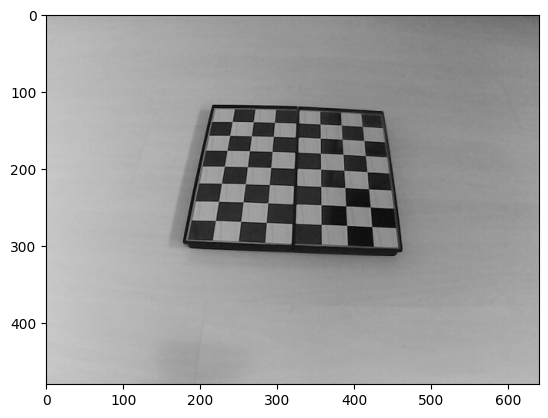

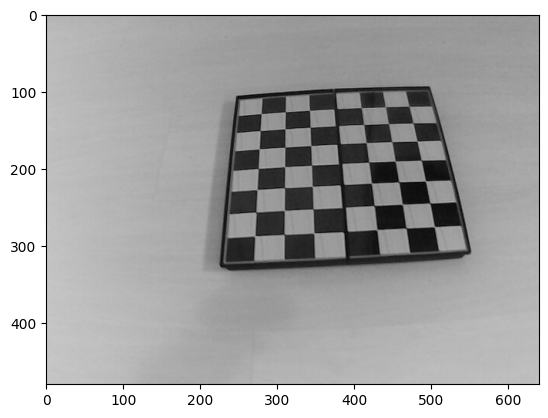

In [52]:
for fname in images:
    img = cv.imread(fname)
    
    img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    img = cv.cvtColor(img, cv.COLOR_GRAY2BGR)
    
    plt.imshow(img)
    plt.show()

## Finding corners

In [40]:
# termination criteria
criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 30, 0.001)

In [41]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((5*5,3), np.float32)
objp[:,:2] = np.mgrid[0:5,0:5].T.reshape(-1,2)

In [42]:
# Arrays to store object points and image points from all the images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

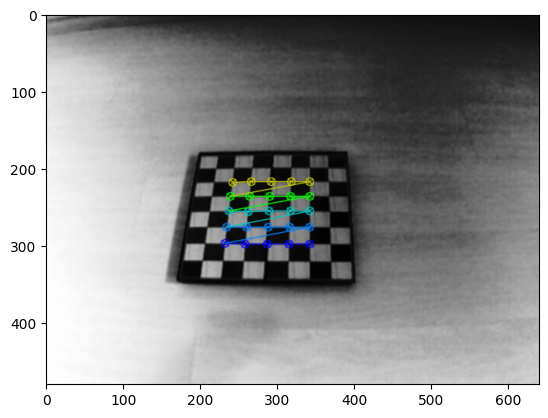

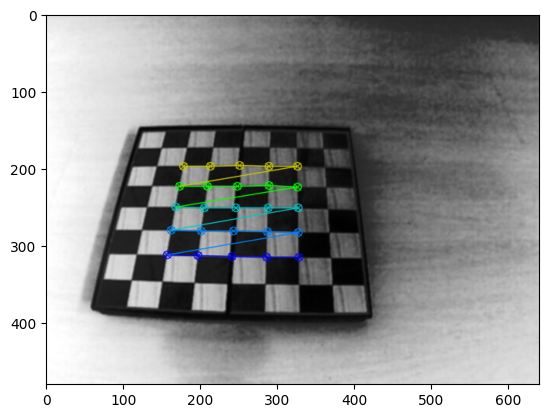

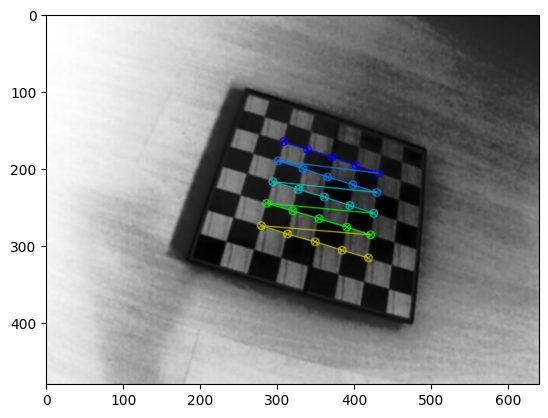

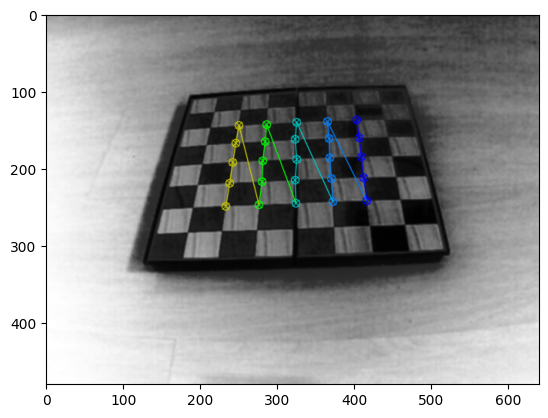

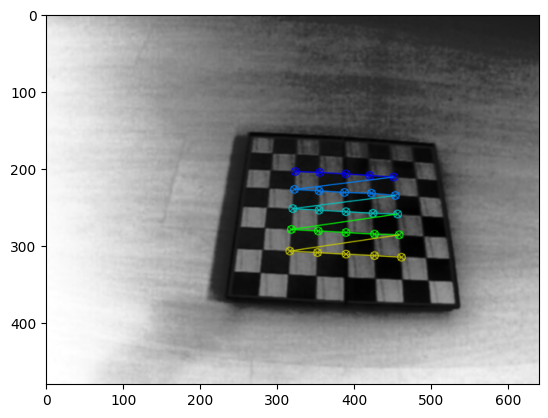

...

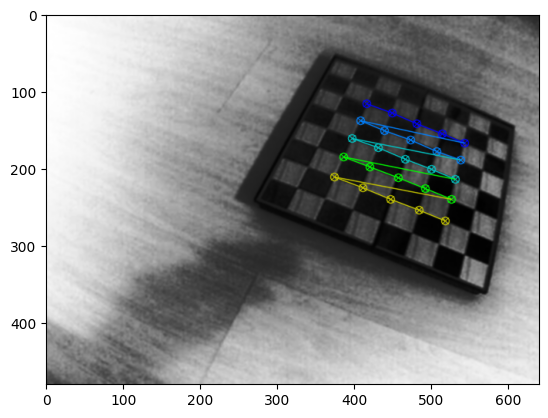

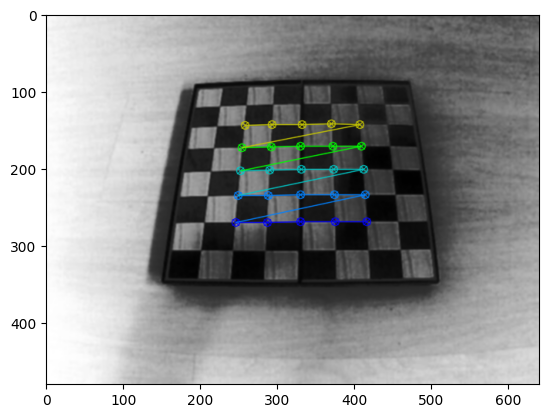

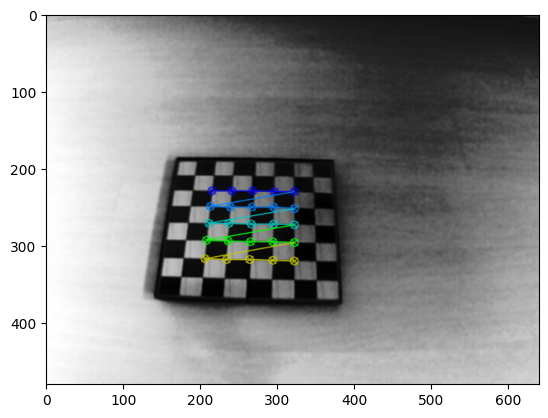

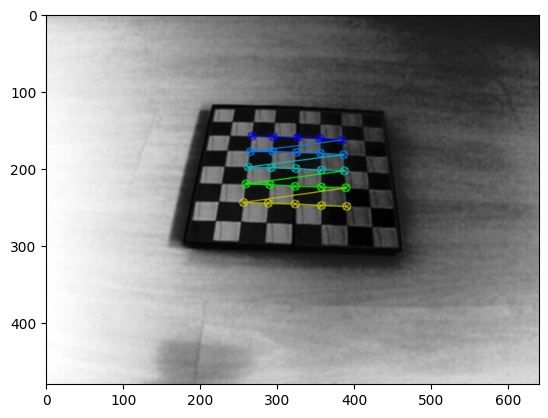

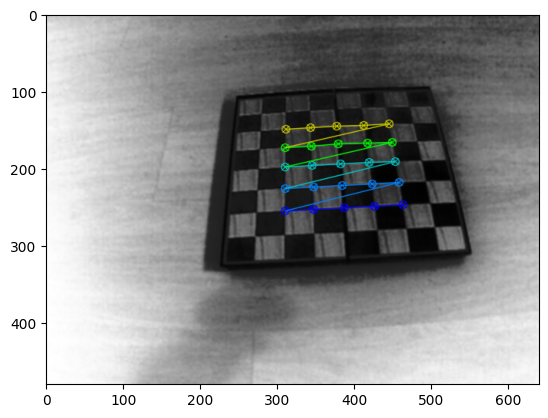

In [43]:
for fname in images:
    img = cv.imread(fname)
    
    img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    img = cv.equalizeHist(img)
    img = cv.cvtColor(img, cv.COLOR_GRAY2BGR)
    
    img = cv.GaussianBlur(img, (5, 5), 0)
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    # Find the chess board corners
    ret, corners = cv.findChessboardCorners(gray, (5,5), None, flags=cv.CALIB_CB_ADAPTIVE_THRESH +
                                                                    cv.CALIB_CB_FAST_CHECK +
                                                                    cv.CALIB_CB_NORMALIZE_IMAGE)

    if ret == True:
        objpoints.append(objp)
        corners2 = cv.cornerSubPix(gray,corners, (11,11), (-1,-1), criteria)
        imgpoints.append(corners2)
        
        # Draw and display the corners
        cv.drawChessboardCorners(img, (5,5), corners2, ret)
        plt.imshow(img)
        plt.show()

## Calibration

In [44]:
ret, mtx, dist, rvecs, tvecs = cv.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

In [54]:
# Camera Matrix
mtx

array([[666.81491657,   0.        , 340.16607585],
       [  0.        , 642.29612021, 291.32367683],
       [  0.        ,   0.        ,   1.        ]])

## Undistortion

## Using undistort

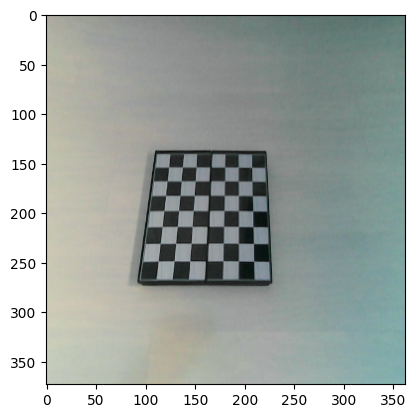

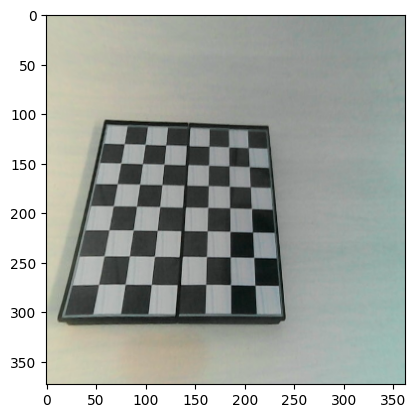

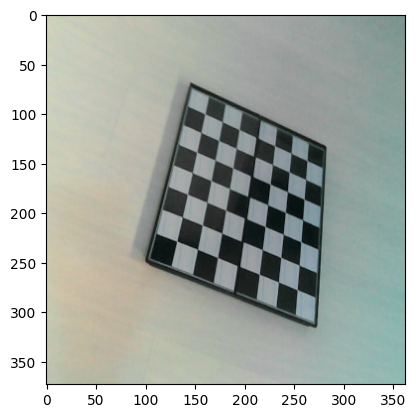

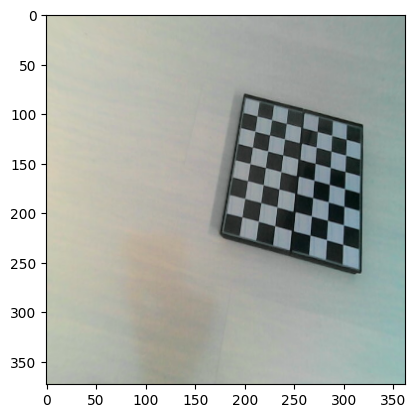

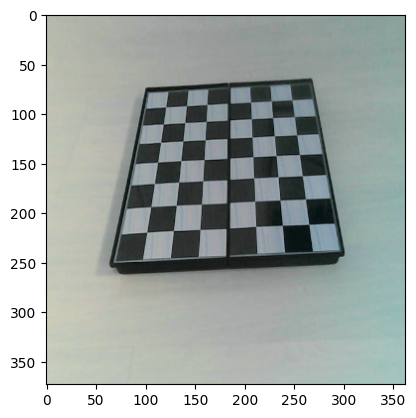

...

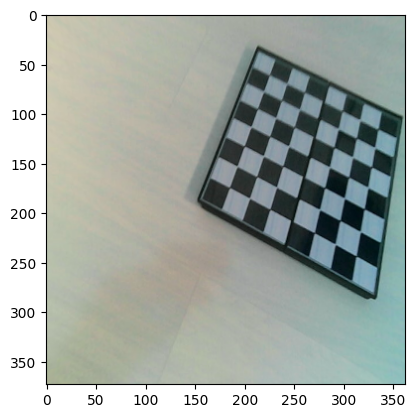

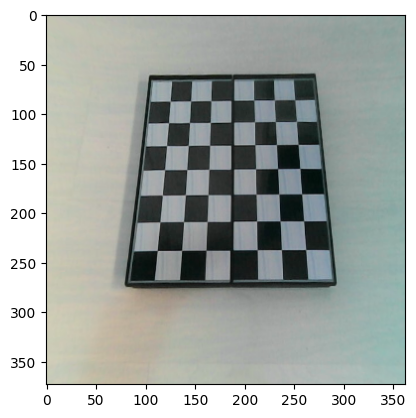

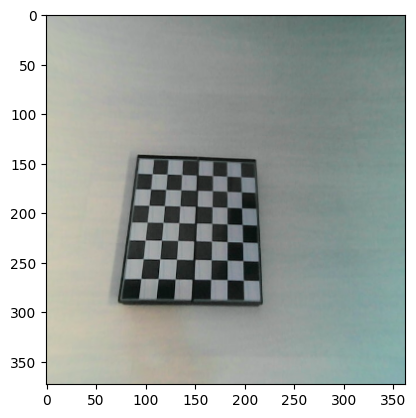

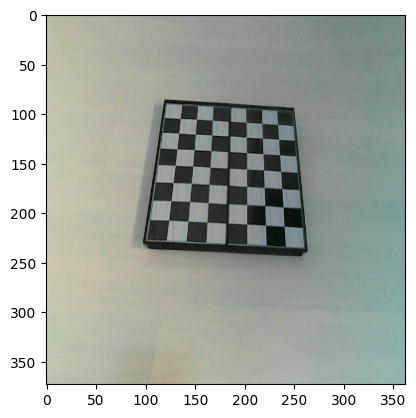

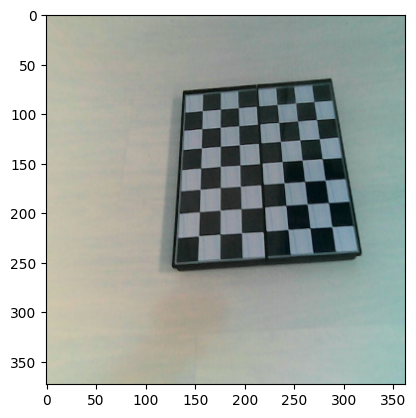

In [45]:
for fname in images:
    img = cv.imread(fname)
    h,  w = img.shape[:2]
    newcameramtx, roi = cv.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1, (w,h))
    dst = cv.undistort(img, mtx, dist, None, newcameramtx)
    
    # crop the image
    x, y, w, h = roi
    dst = dst[y:y+h, x:x+w]
    
    plt.imshow(dst)
    plt.show()

## Using remapping

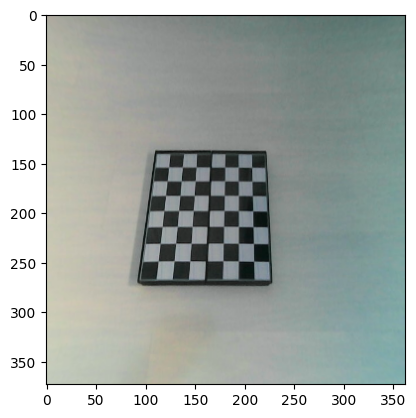

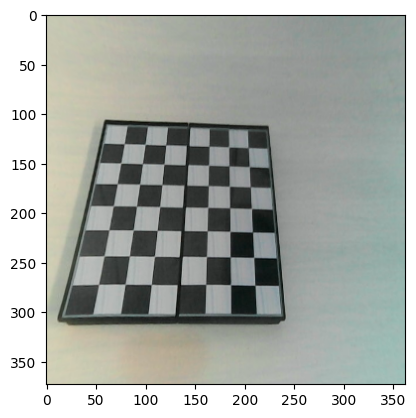

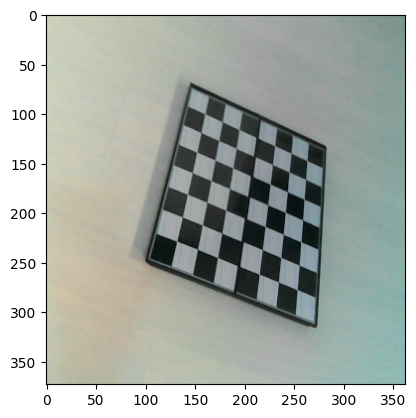

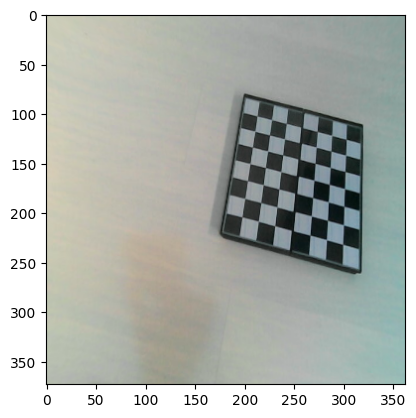

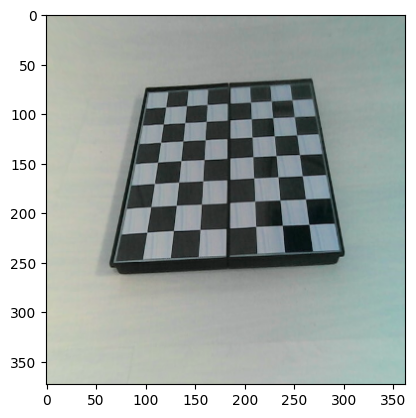

...

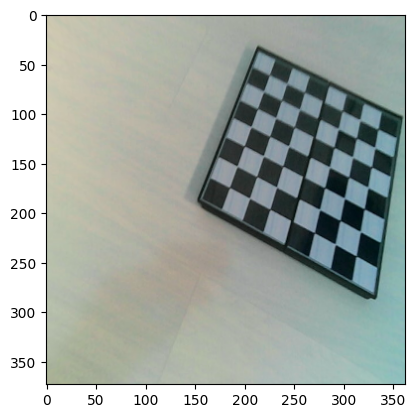

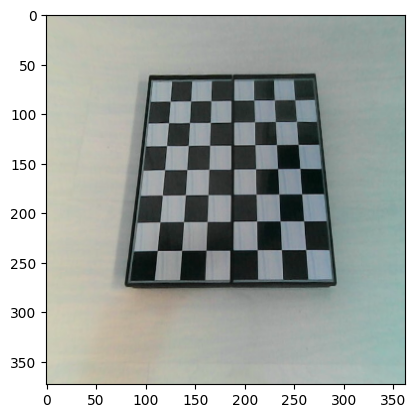

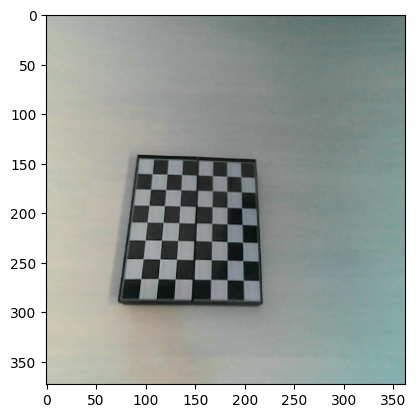

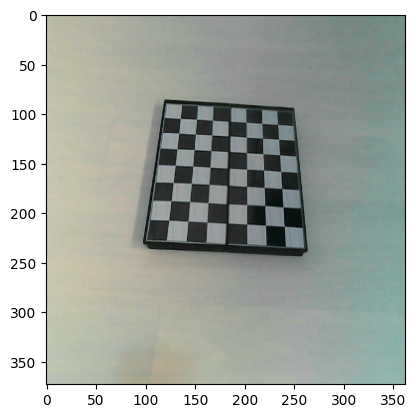

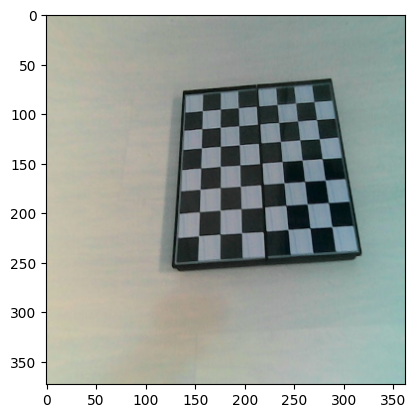

In [36]:
for fname in images:
    img = cv.imread(fname)
    h,  w = img.shape[:2]
    newcameramtx, roi = cv.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1, (w,h))
    mapx, mapy = cv.initUndistortRectifyMap(mtx, dist, None, newcameramtx, (w,h), 5)
    dst = cv.remap(img, mapx, mapy, cv.INTER_LINEAR)
    
    # crop the image
    x, y, w, h = roi
    dst = dst[y:y+h, x:x+w]
    
    plt.imshow(dst)
    plt.show()